# **Modelos Clássicos** 

**Bibliotecas Necessárias**

In [1]:
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import lightgbm as lgb
from xgboost import XGBRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error

**Ler e separar os dados**

In [3]:
file_path = 'Data_noNorm.csv'
data = pd.read_csv(file_path)

# Garantir que a coluna 'Date' está no formato correto e sem o fuso horário
data['Date'] = pd.to_datetime(data['Date'])  # Converter para datetime
data.set_index('Date', inplace=True)  # Definir 'Date' como índice

# Separar os conjuntos de treino, validação e teste
train_data = data.loc[:'2022-12-31']
val_data = data.loc['2023-01-01':'2023-12-31']
test_data = data.loc['2024-01-01':'2024-01-31']

# Separar features (X) e target (y)
X_train = train_data.drop(columns=['Future_Return'])
y_train = train_data['Future_Return']

X_val = val_data.drop(columns=['Future_Return'])
y_val = val_data['Future_Return']

X_test = test_data.drop(columns=['Future_Return'])
y_test = test_data['Future_Return']


**Escolha das melhores features, com recurso ao modelo LightGBM**

Optamos por escolher o **LightGBM**, por ser um modelo com elevada capacidade em lidar com um grande volume de dados, com padrões complexos.\
Além disso, apresenta uma boa eficiência computacional, sem introduzir ruído.

>Referência: *Ke, Guolin, et al. "LightGBM: A highly efficient gradient boosting decision tree." Advances in Neural Information Processing Systems. 2017*


In [4]:
lgb_model = lgb.LGBMRegressor(
    n_estimators=3500, 
    max_depth=10, 
    learning_rate=0.001,
    n_jobs=-1, 
    random_state=42
)
lgb_model.fit(X_train, y_train)

feature_importances = lgb_model.feature_importances_

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.019419 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4906
[LightGBM] [Info] Number of data points in the train set: 1516448, number of used features: 23
[LightGBM] [Info] Start training from score 0.000723


**Plot das melhores features**

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


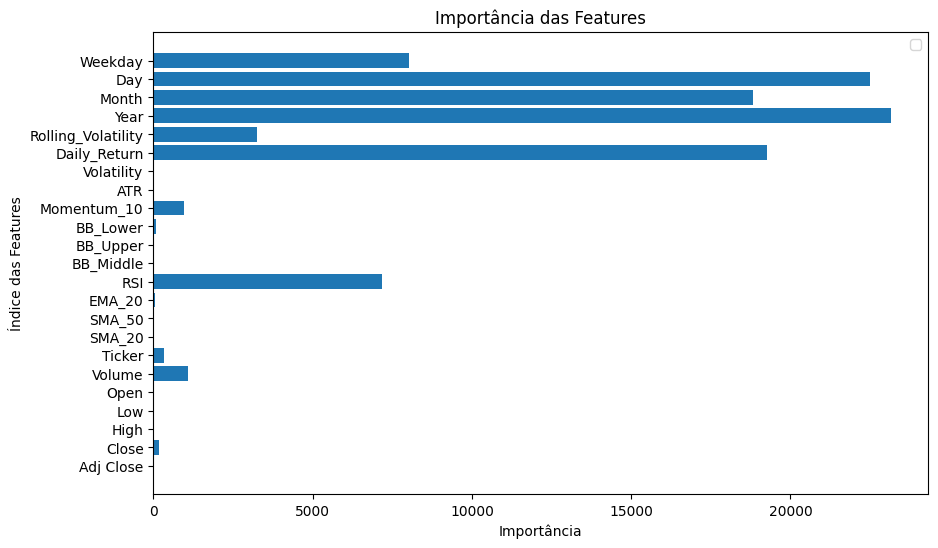

In [5]:
plt.figure(figsize=(10, 6))
plt.barh(X_train.columns, feature_importances)
plt.ylabel('Índice das Features')
plt.xlabel('Importância')
plt.title('Importância das Features')
plt.legend()
plt.show()

In [6]:
feature_importances

array([   28,   172,    16,     7,    15,  1080,   352,     0,     0,
          46,  7191,     0,    26,    72,   951,     6,     0, 19254,
        3248, 23167, 18836, 22503,  8030])

Escolhemos as features com importancia superior à **mediana** das *feature_importances*, uma vez que a mediana não é influenciada por valores extremamente altos ou baixos, ao contrário da média.

In [7]:
selected_features = X_train.columns[feature_importances > np.median(feature_importances)]
print(f"Features selecionadas: {list(selected_features)}")

# Reduzir os datasets às features selecionadas
X_train_selected = X_train[selected_features]
X_val_selected = X_val[selected_features]
X_test_selected = X_test[selected_features]

Features selecionadas: ['Close', 'Volume', 'Ticker', 'RSI', 'Momentum_10', 'Daily_Return', 'Rolling_Volatility', 'Year', 'Month', 'Day', 'Weekday']


**1. Normalização dos dados usando o Min-Max**

Ideal para colunas com valores que possuem limites conhecidos ou métricas específicas que variam dentro de uma faixa pré-definida.\
Neste caso, podemos aplicar o **Min-Max** a indicadores técnicos como *RSI* e *Momentum*.

**2. StandardScaler**

Ideal para variáveis cujas escalas não são limitadas, especialmente aquelas diretamente relacionadas a preços, volumes e volatilidades.\
Assim, podemos aplicar o **StandardScaler** às seguintes features:

- Preços e volumes:
    - *Close*;
    - *Volume*;
    - *Daily_Return*.

- Indicadores de risco e volatilidade:
    - *Rolling_Volatility*.

>Este documento fornece suporte empírico para a utilização da normalização do Z-score e do Min-Max Scaling em tarefas de previsão de ações \
Referência:
*"Forecasting Daily Stock Movement Using a Hybrid Normalization Based Intersection Feature Selection and ANN" by Kumari Binita and Swarnkar Tripti (2023)*

In [8]:
min_max_scaler = MinMaxScaler()
standard_scaler = StandardScaler()

cols_to_normalize_minmax = [col for col in selected_features if col in ['RSI', 'Momentum_10']]
cols_to_normalize_standard = [col for col in selected_features if col in ['Close', 'Volume', 'Daily_Return', 'Rolling_Volatility']]

# Criar cópias para evitar modificar os dados originais
X_train_normalized = X_train_selected.copy()
X_val_normalized = X_val_selected.copy()
X_test_normalized = X_test_selected.copy()

# Aplicar normalização Min-Max nas colunas definidas
X_train_normalized[cols_to_normalize_minmax] = min_max_scaler.fit_transform(X_train_selected[cols_to_normalize_minmax])
X_val_normalized[cols_to_normalize_minmax] = min_max_scaler.transform(X_val_selected[cols_to_normalize_minmax])
X_test_normalized[cols_to_normalize_minmax] = min_max_scaler.transform(X_test_selected[cols_to_normalize_minmax])

# Aplicar normalização StandardScaler nas colunas definidas
X_train_normalized[cols_to_normalize_standard] = standard_scaler.fit_transform(X_train_selected[cols_to_normalize_standard])
X_val_normalized[cols_to_normalize_standard] = standard_scaler.transform(X_val_selected[cols_to_normalize_standard])
X_test_normalized[cols_to_normalize_standard] = standard_scaler.transform(X_test_selected[cols_to_normalize_standard])


**Função para calcular R^2, a partir do coeficiente de pearson**

In [2]:
def r2(y_real, y_pred):   
    # Calcular as médias
    mean_y_real = np.mean(y_real)
    mean_y_pred = np.mean(y_pred)

    # Numerador: Covariância entre y_real e y_pred
    covariance = np.sum((y_real - mean_y_real) * (y_pred - mean_y_pred))

    # Denominador: Produto dos desvios padrão de y_real e y_pred
    std_y_real = np.sqrt(np.sum((y_real - mean_y_real) ** 2))
    std_y_pred = np.sqrt(np.sum((y_pred - mean_y_pred) ** 2))

    # Coeficiente de correlação de Pearson (r)
    pearson_r = covariance / (std_y_real * std_y_pred)

    r2_pearson = pearson_r ** 2
    return r2_pearson

Decidimos implementar 3 modelos diferentes de Machine Learning, o **AdaBoost**, **XGBoost** e o **LoghtGBM**, para prever os retornos diários de cada ação.

# **AdaBoost**

Primeiro, recorremos ao **Adaboost** por ser um modelo robusto em lidar com dados de alta dimensionalidade, além de ter uma boa capacidade para capturar padrões não lineares e revelar um bom desempenho em estudos de contexto financeiro.

Acresce o facto deste modelo possuir ferramentas para reduzir o impacto do ruídos dos dados, uma vez que ele é capaz de se ajustar e focar-se em padrões consistentes, melhorando assim a sua generalização.

>Referências:\
https://www.sciencedirect.com/science/article/pii/S1062940824001669 \
https://www.kaggle.com/code/meuge672/predicting-price-with-adaboost-and-regression#AdaBoost-Algorithm

In [9]:
# Treinar o AdaBoost
adaboost_model = AdaBoostRegressor(n_estimators=20, learning_rate=0.001, loss='exponential', random_state=42)

# Treinar o modelo com o conjunto de treino
adaboost_model.fit(X_train_normalized, y_train)

# Avaliar o modelo no conjunto de validação
y_val_pred = adaboost_model.predict(X_val_normalized)
val_mae = mean_absolute_error(y_val, y_val_pred)
val_mse = mean_squared_error(y_val, y_val_pred)
val_rmse = np.sqrt(val_mse)
val_r2 = r2(y_val, y_val_pred)

print(f"Validação - MAE: {val_mae:.5f}")
print(f"Validação - MSE: {val_mse:.5f}")
print(f"Validação - RMSE: {val_rmse:.5f}")
print(f"Validação - R²: {val_r2:.5f}")

Validação - MAE: 0.01204
Validação - MSE: 0.00031
Validação - RMSE: 0.01756
Validação - R²: 0.07003


In [10]:
# Treinar no conjunto combinado (treino + validação)
X_train_val_selected = pd.concat([X_train_normalized, X_val_normalized])
y_train_val = pd.concat([y_train, y_val])
adaboost_model.fit(X_train_val_selected, y_train_val)

AdaBoostRegressor(learning_rate=0.001, loss='exponential', n_estimators=20,
                  random_state=42)

In [11]:
# Avaliar o conjunto de teste
y_test_pred = adaboost_model.predict(X_test_normalized)
test_mae = mean_absolute_error(y_test, y_test_pred)
test_mse = mean_squared_error(y_test, y_test_pred)
test_rmse = np.sqrt(test_mse)
test_r2 = r2(y_test, y_test_pred)

print(f"Teste - MAE: {test_mae:.5f}")
print(f"Teste - MSE: {test_mse:.5f}")
print(f"Teste - RMSE: {test_rmse:.5f}")
print(f"Teste - R²: {test_r2:.5f}")

Teste - MAE: 0.01139
Teste - MSE: 0.00028
Teste - RMSE: 0.01676
Teste - R²: 0.03132


# Plots dos Valores Reais e dos Valores Previstos por Empresa

In [12]:
# Criar o DataFrame com os valores reais e previstos
y_test_df = pd.DataFrame(y_test.values, columns=['Real_Return'], index=y_test.index)
y_test_pred_df = pd.DataFrame(y_test_pred, columns=['Predicted_Return'], index=y_test.index)

# Concatenar os valores reais, previstos e os Tickers 
df_test = pd.concat([y_test_df, y_test_pred_df], axis=1)
df_test['Ticker'] = X_test['Ticker']

# Gráficos por empresa
tickers = df_test['Ticker'].unique()
n_col = 5  # Número de gráficos por linha 
n_row = int(np.ceil(len(tickers) / n_col))  # Número de linhas necessárias

print("Linha azul --- Valores Reais")
print("Linha laranja --- Valores Previstos")

# Criar os subgráficos
fig, axes = plt.subplots(n_row, n_col, figsize=(18, 3 * n_row))  
axes = axes.flatten()  

# Iterar sobre os tickers e plotar os gráficos
for i, ticker in enumerate(tickers):
    # Filtrar os dados para o Ticker específico
    ticker_data = df_test[df_test['Ticker'] == ticker]
    
    # Plotar os valores reais e previstos ao longo do tempo
    ax = axes[i]    
    ax.plot(ticker_data.index, ticker_data['Real_Return'], label='Valores Reais', color='blue')
    ax.plot(ticker_data.index, ticker_data['Predicted_Return'], label='Previsões', color='orange', linestyle='dashed')
    ax.set_title(f'Previsão de Retornos para {ticker}', fontsize=6)  
    ax.set_xlabel('Data', fontsize=6) 
    ax.set_ylabel('Retorno Futuro', fontsize=6) 
    ax.tick_params(axis='x', rotation=45, labelsize=6)  
    ax.tick_params(axis='y', labelsize=6)

plt.subplots_adjust(hspace=0.5, wspace=0.5, right=0.85)  
plt.tight_layout(pad=3.0) 
plt.show()

Linha azul --- Valores Reais
Linha laranja --- Valores Previstos


In [ ]:
#Guardar o csv com os valores reais e previstos
df_test.to_csv("predicted_vs_real_returns_adaboost.csv", index=True)
print("DataFrame salvo como 'predicted_vs_real_returns_adaboost.csv'.")

DataFrame salvo como 'predicted_vs_real_returns_adaboost.csv'.


# **XGBoost**

De seguida, decidimos utilizar o **XGBoost** por ser um modelo eficiente em classificações e por apresentar um desempenho positivo com grandes volumes de dados.

>Referência: https://www.researchgate.net/publication/379076543_Predicting_the_SP_500_stock_market_with_machine_learning_models

In [13]:
xgb_model = XGBRegressor(
    n_estimators=900,
    max_depth=10,
    learning_rate=0.001,
    random_state=42,
    n_jobs=-1
)
xgb_model.fit(X_train_normalized, y_train)

# Avaliar o conjunto de validação
y_val_pred = xgb_model.predict(X_val_normalized)
val_mae = mean_absolute_error(y_val, y_val_pred)
val_mse = mean_squared_error(y_val, y_val_pred)
val_rmse = np.sqrt(val_mse)
val_r2 = r2(y_val, y_val_pred)

print(f"Validação - MAE: {val_mae:.5f}")
print(f"Validação - MSE: {val_mse:.5f}")
print(f"Validação - RMSE: {val_rmse:.5f}")
print(f"Validação - R²: {val_r2:.5f}")

Validação - MAE: 0.01192
Validação - MSE: 0.00030
Validação - RMSE: 0.01746
Validação - R²: 0.07185


In [14]:
xgb_model.fit(X_train_val_selected, y_train_val)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.001, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=10, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=900, n_jobs=-1,
             num_parallel_tree=None, random_state=42, ...)

In [15]:
# Avaliar o conjunto de teste
y_test_pred = xgb_model.predict(X_test_normalized)
test_mae = mean_absolute_error(y_test, y_test_pred)
test_mse = mean_squared_error(y_test, y_test_pred)
test_rmse = np.sqrt(test_mse)
val_r2 = r2(y_val, y_val_pred)

print(f"Teste - MAE: {test_mae:.5f}")
print(f"Teste - MSE: {test_mse:.5f}")
print(f"Teste - RMSE: {test_rmse:.5f}")
print(f"Teste - R²: {val_r2:.5f}")

Teste - MAE: 0.01110
Teste - MSE: 0.00027
Teste - RMSE: 0.01647
Teste - R²: 0.07185


# Plots dos Valores Reais e dos Valores Previstos por Empresa

In [16]:
# Criar o DataFrame com os valores reais e previstos
y_test_df = pd.DataFrame(y_test.values, columns=['Real_Return'], index=y_test.index)
y_test_pred_df = pd.DataFrame(y_test_pred, columns=['Predicted_Return'], index=y_test.index)
df_test = pd.concat([y_test_df, y_test_pred_df], axis=1)
df_test['Ticker'] = X_test['Ticker']

# Gráficos por empresa
tickers = df_test['Ticker'].unique()
n_col = 5
n_row = int(np.ceil(len(tickers) / n_col))

# Criar os subgráficos
fig, axes = plt.subplots(n_row, n_col, figsize=(18, 3 * n_row))
axes = axes.flatten()

for i, ticker in enumerate(tickers):
    ticker_data = df_test[df_test['Ticker'] == ticker]
    ax = axes[i]
    ax.plot(ticker_data.index, ticker_data['Real_Return'], label='Valores Reais', color='blue')
    ax.plot(ticker_data.index, ticker_data['Predicted_Return'], label='Previsões', color='orange', linestyle='dashed')
    ax.set_title(f'Previsão de Retornos para {ticker}', fontsize=6)
    ax.set_xlabel('Data', fontsize=6)
    ax.set_ylabel('Retorno Futuro', fontsize=6)
    ax.tick_params(axis='x', rotation=45, labelsize=6)
    ax.tick_params(axis='y', labelsize=6)

plt.subplots_adjust(hspace=0.5, wspace=0.5, right=0.85)
plt.tight_layout(pad=3.0)
plt.show()

In [17]:
#Guardar o csv com os valores reais e previstos
df_test.to_csv("predicted_vs_real_returns_xgboost.csv", index=True)
print("DataFrame salvo como 'predicted_vs_real_returns_xgboost.csv'.")

DataFrame salvo como 'predicted_vs_real_returns_xgboost.csv'.


# **LightGBM**

Posteriormente, optamos por usar também o **LightGBM** pela sua eficiência computacional e pela capacidade de lidar com dados complexos e de alta dimensionalidade.

>Referência: \
https://www.researchgate.net/publication/347420761_Predicting_the_SP500_Index_Trend_Based_on_GBDT_and_LightGBM_Methods \
https://www.sciencedirect.com/science/article/pii/S1877050922020130


In [18]:
model = lgb.LGBMRegressor(
    n_estimators=900,          
    learning_rate=0.001,       
    random_state=42,            
    n_jobs=-1             
)

# Treinar o modelo com o conjunto de treino
model.fit(X_train_normalized, y_train)

# Avaliar o modelo no conjunto de validação
y_val_pred = model.predict(X_val_normalized)
val_mae = mean_absolute_error(y_val, y_val_pred)
val_mse = mean_squared_error(y_val, y_val_pred)
val_rmse = np.sqrt(val_mse)
val_r2 = r2(y_val, y_val_pred)

print(f"Validação - MAE: {val_mae:.5f}")
print(f"Validação - MSE: {val_mse:.5f}")
print(f"Validação - RMSE: {val_rmse:.5f}")
print(f"Validação - R²: {val_r2:.5f}")

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009574 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1846
[LightGBM] [Info] Number of data points in the train set: 1516448, number of used features: 11
[LightGBM] [Info] Start training from score 0.000723
Validação - MAE: 0.01190
Validação - MSE: 0.00030
Validação - RMSE: 0.01746
Validação - R²: 0.07513


In [19]:
model.fit(X_train_val_selected, y_train_val)

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009461 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1847
[LightGBM] [Info] Number of data points in the train set: 1638675, number of used features: 11
[LightGBM] [Info] Start training from score 0.000724


LGBMRegressor(learning_rate=0.001, n_estimators=900, n_jobs=-1, random_state=42)

In [20]:
# Avaliar o conjunto de teste
y_test_pred = model.predict(X_test_normalized)
test_mae = mean_absolute_error(y_test, y_test_pred)
test_mse = mean_squared_error(y_test, y_test_pred)
test_rmse = np.sqrt(test_mse)
test_r2 = r2(y_test, y_test_pred)

print(f"Teste - MAE: {test_mae:.5f}")
print(f"Teste - MSE: {test_mse:.5f}")
print(f"Teste - RMSE: {test_rmse:.5f}")
print(f"Teste - R²: {test_r2:.5f}")

Teste - MAE: 0.01107
Teste - MSE: 0.00027
Teste - RMSE: 0.01644
Teste - R²: 0.03408


# Plots dos Valores Reais e dos Valores Previstos por Empresa

In [ ]:
# Criar o DataFrame com os valores reais e previstos
y_test_df = pd.DataFrame(y_test.values, columns=['Real_Return'], index=y_test.index)
y_test_pred_df = pd.DataFrame(y_test_pred, columns=['Predicted_Return'], index=y_test.index)
df_test = pd.concat([y_test_df, y_test_pred_df], axis=1)
df_test['Ticker'] = X_test['Ticker']

# Gráficos por empresa
tickers = df_test['Ticker'].unique()
n_col = 5  
n_row = int(np.ceil(len(tickers) / n_col))  

print("Linha azul --- Valores Reais")
print("Linha laranja --- Valores Previstos")

# Criar os subgráficos
fig, axes = plt.subplots(n_row, n_col, figsize=(18, 3 * n_row))  
axes = axes.flatten()  

# Iterar sobre os tickers e plotar os gráficos
for i, ticker in enumerate(tickers):
    ticker_data = df_test[df_test['Ticker'] == ticker]
    ax = axes[i]  
    ax.plot(ticker_data.index, ticker_data['Real_Return'], label='Valores Reais', color='blue')
    ax.plot(ticker_data.index, ticker_data['Predicted_Return'], label='Previsões', color='orange', linestyle='dashed')
    ax.set_title(f'Previsão de Retornos para {ticker}', fontsize=6)  
    ax.set_xlabel('Data', fontsize=6) 
    ax.set_ylabel('Retorno Futuro', fontsize=6) 
    ax.tick_params(axis='x', rotation=45, labelsize=6)  
    ax.tick_params(axis='y', labelsize=6)

plt.subplots_adjust(hspace=0.5, wspace=0.5, right=0.85)  
plt.tight_layout(pad=3.0) 
plt.show()

Linha azul --- Valores Reais
Linha laranja --- Valores Previstos


In [21]:
#Guardar o csv com os valores reais e previstos
df_test.to_csv("predicted_vs_real_returns_lgbm.csv", index=True)
print("DataFrame salvo como 'predicted_vs_real_returns_lgbm.csv'.")

DataFrame salvo como 'predicted_vs_real_returns_lgbm.csv'.


# Valores Reais e Previsões

In [9]:
ada=pd.read_csv("predicted_vs_real_returns_adaboost.csv")
ada

,Date,Real_Return,Predicted_Return,Ticker
0,2024-01-02 00:00:00+00:00,-0.035787,0.001238,0
1,2024-01-02 00:00:00+00:00,0.031296,-0.012733,1
2,2024-01-02 00:00:00+00:00,-0.012193,0.010441,2
3,2024-01-02 00:00:00+00:00,-0.001999,-0.006231,3
4,2024-01-02 00:00:00+00:00,0.017234,0.001238,4
...,...,...,...,...
10285,2024-01-31 00:00:00+00:00,-0.019456,0.001238,489
10286,2024-01-31 00:00:00+00:00,-0.011516,-0.006246,490
10287,2024-01-31 00:00:00+00:00,-0.008651,-0.002712,491
10288,2024-01-31 00:00:00+00:00,-0.018910,-0.002161,492


In [96]:
xgb=pd.read_csv("predicted_vs_real_returns_xgboost.csv")
xgb

,Date,Real_Return,Predicted_Return,Ticker
0,2024-01-02 00:00:00+00:00,-0.035787,0.001099,0
1,2024-01-02 00:00:00+00:00,0.031296,-0.004716,1
2,2024-01-02 00:00:00+00:00,-0.012193,0.003549,2
3,2024-01-02 00:00:00+00:00,-0.001999,-0.002285,3
4,2024-01-02 00:00:00+00:00,0.017234,0.001099,4
...,...,...,...,...
10285,2024-01-31 00:00:00+00:00,-0.019456,0.001394,489
10286,2024-01-31 00:00:00+00:00,-0.011516,-0.004909,490
10287,2024-01-31 00:00:00+00:00,-0.008651,-0.002957,491
10288,2024-01-31 00:00:00+00:00,-0.018910,0.000058,492


In [97]:
lgb=pd.read_csv("predicted_vs_real_returns_lgbm.csv")
lgb

,Date,Real_Return,Predicted_Return,Ticker
0,2024-01-02 00:00:00+00:00,-0.035787,0.000204,0
1,2024-01-02 00:00:00+00:00,0.031296,-0.009541,1
2,2024-01-02 00:00:00+00:00,-0.012193,0.006513,2
3,2024-01-02 00:00:00+00:00,-0.001999,-0.003507,3
4,2024-01-02 00:00:00+00:00,0.017234,0.000204,4
...,...,...,...,...
10285,2024-01-31 00:00:00+00:00,-0.019456,0.001357,489
10286,2024-01-31 00:00:00+00:00,-0.011516,-0.005276,490
10287,2024-01-31 00:00:00+00:00,-0.008651,-0.002890,491
10288,2024-01-31 00:00:00+00:00,-0.018910,-0.002172,492


# **Monte Carlo**

O **Monte Carlo** foi desenvolvido com o objetivo de simular várias combinações de ações para encontrar a melhor estratégia de investimento, tendo por base o retono previsto e o retorno real.

Primeiro, implementámos a função *monte_carlo_selection* responsável por gerar combinações aleatórias de ações disponíveis em cada dia e por selecionar a melhor, ou seja, a que maximiza o retorno previsto.

Definimos também a função *optimize_portfolio*, que aplica a função anterior a vários dias consecutivos e organiza os resultados. 

In [126]:
def monte_carlo_selection(df_day, max_combinations, explore_rate=0.1):
    tickers = df_day['Ticker'].unique()
    num_tickers = len(tickers)
    best_combination = None
    best_predicted_return = -np.inf
    best_real_return = -np.inf  # Inicializa o melhor retorno real

    for i in range(max_combinations):
        if random.random() < explore_rate and best_combination is not None:
            # Modificar uma combinação já conhecida
            num_changes = random.randint(1, len(best_combination))
            random_combination = list(best_combination)
            for _ in range(num_changes):
                if random.random() < 0.5 and random_combination:
                    # Remove um ticker aleatório
                    random_combination.pop(random.randint(0, len(random_combination) - 1))
                else:
                    # Adiciona um novo ticker aleatório
                    available_tickers = list(set(tickers) - set(random_combination))
                    if available_tickers:  # Verificar se há tickers disponíveis
                        new_ticker = random.choice(available_tickers)
                        random_combination.append(new_ticker)
        else:
            # Gerar uma nova combinação
            num_selected = random.randint(1, num_tickers)
            random_combination = random.sample(list(tickers), num_selected)

        # Filtrar o DataFrame para as ações na combinação
        df_comb = df_day[df_day['Ticker'].isin(random_combination)]
        
        # Calcular o retorno total previsto e real
        total_predicted_return = df_comb['Predicted_Return'].sum()
        total_real_return = df_comb['Real_Return'].sum()
        
        # Verificar se essa combinação é a melhor até ao momento
        if total_predicted_return > best_predicted_return and total_predicted_return > 0:
            best_combination = random_combination
            best_predicted_return = total_predicted_return
            best_real_return = total_real_return

    # Verificar se nenhuma combinação válida foi encontrada
    if best_combination is None:
        best_combination = []
        best_predicted_return = 0
        best_real_return = 0

    return {
        "best_combination": best_combination,
        "com_predicted_return": best_predicted_return,
        "com_real_return": best_real_return  
    }

# Aplicar a otimização por dia
def optimize_portfolio(df_test, max_combinations=1000):
    results = []
    for date, df_day in df_test.groupby('Date'):  
        
        result = monte_carlo_selection(df_day, max_combinations=max_combinations)
        result['Date'] = date
        results.append(result)
    
    return pd.DataFrame(results)

In [ ]:
results_ada = optimize_portfolio(ada)

In [ ]:
results_ada

,best_combination,com_predicted_return,com_real_return,Date
0,"[332, 210, 399, 235, 134, 255, 463, 419, 335, ...",0.249854,-0.417630,2024-01-02 00:00:00+00:00
1,[],0.000000,0.000000,2024-01-03 00:00:00+00:00
2,"[158, 44, 466, 285, 183, 301, 334, 385, 108, 8...",0.167301,-0.691942,2024-01-04 00:00:00+00:00
3,"[366, 351, 170, 373, 389, 155, 7, 243, 36, 377...",0.825299,1.292712,2024-01-05 00:00:00+00:00
4,"[80, 12, 453, 22, 434, 483, 474, 67, 346, 14, ...",2.321211,5.288682,2024-01-08 00:00:00+00:00
5,[],0.000000,0.000000,2024-01-09 00:00:00+00:00
6,"[433, 43, 214, 263, 387, 288, 145, 256, 366, 2...",0.646495,0.804060,2024-01-10 00:00:00+00:00
7,"[107, 25, 34, 263, 259, 333, 68, 452, 472, 192...",0.075357,-0.231471,2024-01-11 00:00:00+00:00
8,"[470, 407, 324, 63, 234, 40, 312, 54, 83, 59, ...",0.216103,-0.336519,2024-01-12 00:00:00+00:00
9,[],0.000000,0.000000,2024-01-16 00:00:00+00:00


In [127]:
results_xgb = optimize_portfolio(xgb)

In [128]:
results_xgb

,best_combination,com_predicted_return,com_real_return,Date
0,"[155, 277, 105, 49, 443, 58, 433, 344, 184, 44...",0.422839,-0.284935,2024-01-02 00:00:00+00:00
1,"[259, 408, 490, 314, 215, 318, 392, 145, 113]",0.036072,-0.158430,2024-01-03 00:00:00+00:00
2,"[334, 490, 179, 403, 318, 278, 42, 477, 22, 15...",0.219563,-0.545900,2024-01-04 00:00:00+00:00
3,"[385, 482, 448, 312, 192, 252, 42, 245, 59, 33...",0.638623,1.209268,2024-01-05 00:00:00+00:00
4,"[457, 102, 442, 14, 36, 289, 191, 196, 450, 46...",1.652434,5.373327,2024-01-08 00:00:00+00:00
5,"[11, 292, 401, 216, 410, 456, 357, 142, 160, 4...",0.053672,-0.112462,2024-01-09 00:00:00+00:00
6,"[47, 402, 143, 274, 312, 315, 27, 271, 174, 32...",0.476484,0.774472,2024-01-10 00:00:00+00:00
7,"[430, 147, 90, 336, 47, 364, 18, 427, 357, 122...",0.100031,-0.299430,2024-01-11 00:00:00+00:00
8,"[216, 388, 142, 320, 112, 19, 305, 173, 155, 4...",0.307980,-0.490698,2024-01-12 00:00:00+00:00
9,"[421, 197, 388, 447, 328, 68, 32, 36, 284, 294...",0.024106,-0.073937,2024-01-16 00:00:00+00:00


In [129]:
results_lgb = optimize_portfolio(lgb)

In [130]:
results_lgb

,best_combination,com_predicted_return,com_real_return,Date
0,"[401, 14, 478, 83, 178, 270, 417, 382, 440, 47...",0.329036,0.053603,2024-01-02 00:00:00+00:00
1,[],0.000000,0.000000,2024-01-03 00:00:00+00:00
2,"[421, 244, 227, 61, 232, 27, 86, 12, 184, 53, ...",0.207229,-0.543304,2024-01-04 00:00:00+00:00
3,"[336, 399, 208, 311, 6, 165, 260, 210, 68, 373...",0.702346,1.302176,2024-01-05 00:00:00+00:00
4,"[467, 358, 56, 246, 60, 241, 475, 323, 83, 253...",1.834611,5.212264,2024-01-08 00:00:00+00:00
5,"[398, 171, 104, 34, 413, 82, 325, 356, 112, 18...",0.058263,-0.120112,2024-01-09 00:00:00+00:00
6,"[127, 312, 45, 87, 27, 329, 396, 468, 65, 113,...",0.544718,0.865902,2024-01-10 00:00:00+00:00
7,"[336, 33, 333, 357, 91, 5, 447, 483, 250, 351,...",0.115833,-0.258386,2024-01-11 00:00:00+00:00
8,"[405, 293, 88, 387, 270, 235, 435, 197, 80, 26...",0.279246,-0.526770,2024-01-12 00:00:00+00:00
9,"[400, 89, 473, 49, 112, 285, 121, 82, 476, 98,...",0.038955,-0.207875,2024-01-16 00:00:00+00:00


# Cálculo das métricas

- **Métricas financeiras**: Avaliam os retornos médios e acumulados, tanto previstos como reais, permitindo analisar o crescimento do portefólio ao longo do tempo.

- **Métricas de performance**: Medem a qualidade das previsões e a eficácia do portólio em alcançar retornos positivos. Estas métricas envolvem a taxa de acerto, isto é, a proporção de dias com retornos reais positivos (*Hit Rate*), o erro absoluto médio (MAE) e o coeficiente de determinação (R²).

- **Métricas de risco**: Avaliam a relação entre o retorno e a volatilidade para determinar a eficiência do portefólio em gerar retornos ajustados ao risco (*Sharpe Ratio* real e previsto).

- **Métricas diárias**: Estas métricas, retorno médio diário, volatilidade diária e *Sharpe Ration* , avaliam a performance do modelo diariamente.


In [31]:
def evaluate_model_performance(results_df):
    # Filtrar apenas dias com combinações selecionadas
    selected_days = results_df[results_df['best_combination'].apply(len) > 0].copy()  
    
    # Retornos previstos e reais
    predicted_returns = selected_days['com_predicted_return']
    real_returns = selected_days['com_real_return']
    
    # Cálculo de métricas principais
    metrics = {}
    metrics['Average_Predicted_Return'] = predicted_returns.mean()
    metrics['Average_Real_Return'] = real_returns.mean()
    metrics['Hit_Rate'] = (real_returns > 0).mean()
    metrics['MAE'] = np.mean(np.abs(predicted_returns - real_returns))
    metrics['R2'] = r2(real_returns, predicted_returns) if len(real_returns) > 1 else np.nan
    metrics['Sharpe_Ratio_Real'] = (
        real_returns.mean() / real_returns.std() if real_returns.std() > 0 else np.nan
    )
    metrics['Sharpe_Ratio_Predicted'] = (
        predicted_returns.mean() / predicted_returns.std() if predicted_returns.std() > 0 else np.nan
    )
    
    # Cálculo de retornos acumulados 
    selected_days.loc[:, 'Cumulative_Real_Return'] = (1 + real_returns).cumprod()
    selected_days.loc[:, 'Cumulative_Predicted_Return'] = (1 + predicted_returns).cumprod()
    
    metrics['Cumulative_Real_Return_Final'] = selected_days['Cumulative_Real_Return'].iloc[-1]
    metrics['Cumulative_Predicted_Return_Final'] = selected_days['Cumulative_Predicted_Return'].iloc[-1]
    
    # Cálculo de retornos diários com base nos acumulados 
    selected_days.loc[:, 'daily_real_return'] = selected_days['Cumulative_Real_Return'].pct_change()
    selected_days.loc[:, 'daily_predicted_return'] = selected_days['Cumulative_Predicted_Return'].pct_change()
    
    metrics['Daily_Mean_Real_Return'] = selected_days['daily_real_return'].mean()
    metrics['Daily_Mean_Predicted_Return'] = selected_days['daily_predicted_return'].mean()
    metrics['Daily_Std_Real_Return'] = selected_days['daily_real_return'].std()
    metrics['Daily_Std_Predicted_Return'] = selected_days['daily_predicted_return'].std()
    
    # Sharpe Ratios diários
    metrics['Sharpe_Ratio_Daily_Real'] = (
        metrics['Daily_Mean_Real_Return'] / metrics['Daily_Std_Real_Return']
        if metrics['Daily_Std_Real_Return'] > 0 else np.nan
    )
    metrics['Sharpe_Ratio_Daily_Predicted'] = (
        metrics['Daily_Mean_Predicted_Return'] / metrics['Daily_Std_Predicted_Return']
        if metrics['Daily_Std_Predicted_Return'] > 0 else np.nan
    )
    
    # Formatar resultados para apresentação
    formatted_results = f"""
    ### Resumo de Desempenho do Modelo Preditivo ###
    
    **Métricas de Retorno:**
    - Retorno Médio Previsto: {metrics['Average_Predicted_Return']:.4f}
    - Retorno Médio Real: {metrics['Average_Real_Return']:.4f}
    - Retorno Acumulado Final (Real): {metrics['Cumulative_Real_Return_Final']:.4f}
    - Retorno Acumulado Final (Previsto): {metrics['Cumulative_Predicted_Return_Final']:.4f}
    
    **Métricas de Performance:**
    - Taxa de Acerto (Hit Rate): {metrics['Hit_Rate']:.2%}
    - Erro Absoluto Médio (MAE): {metrics['MAE']:.4f}
    - Coeficiente de Determinação (R²): {metrics['R2']:.4f}
    
    **Métricas de Risco:**
    - Sharpe Ratio (Real): {metrics['Sharpe_Ratio_Real']:.4f}
    - Sharpe Ratio (Previsto): {metrics['Sharpe_Ratio_Predicted']:.4f}
    
    **Métricas Diárias:**
    - Retorno Médio Diário (Real): {metrics['Daily_Mean_Real_Return']:.4f}
    - Retorno Médio Diário (Previsto): {metrics['Daily_Mean_Predicted_Return']:.4f}
    - Volatilidade Diária (Real): {metrics['Daily_Std_Real_Return']:.4f}
    - Volatilidade Diária (Previsto): {metrics['Daily_Std_Predicted_Return']:.4f}
    - Sharpe Ratio Diário (Real): {metrics['Sharpe_Ratio_Daily_Real']:.4f}
    - Sharpe Ratio Diário (Previsto): {metrics['Sharpe_Ratio_Daily_Predicted']:.4f}
    """
    
    print(formatted_results)

# **Desempenho do AdaBoost**

In [ ]:
evaluate_model_performance(results_ada)


    ### Resumo de Desempenho do Modelo Preditivo ###
    
    **Métricas de Retorno:**
    - Retorno Médio Previsto: 0.9065
    - Retorno Médio Real: 1.5526
    - Retorno Acumulado Final (Real): 6378.0368
    - Retorno Acumulado Final (Previsto): 5916.6305
    
    **Métricas de Performance:**
    - Taxa de Acerto (Hit Rate): 73.33%
    - Erro Absoluto Médio (MAE): 1.0412
    - Coeficiente de Determinação (R²): 0.9856
    
    **Métricas de Risco:**
    - Sharpe Ratio (Real): 0.7785
    - Sharpe Ratio (Previsto): 1.2402
    
    **Métricas Diárias:**
    - Retorno Médio Diário (Real): 1.6933
    - Retorno Médio Diário (Previsto): 0.9534
    - Volatilidade Diária (Real): 1.9910
    - Volatilidade Diária (Previsto): 0.7348
    - Sharpe Ratio Diário (Real): 0.8505
    - Sharpe Ratio Diário (Previsto): 1.2976
    


Pela análise das métricas, percebemos que o AdaBoost demostrou uma elevada capacidade para prever, com um R² e uma *Hit Rate* elevados.

No entanto, o modelo substima os retornos reais, tal como podemos obversar na diferença entre os retornos médios e os acumulados.

Apesar disso, este revela uma boa gestão de risco, apresentando um *Sharp Ratio* real positivo, embora inferior ao previsto. 

# **Desempenho do XGBoost**

In [131]:
evaluate_model_performance(results_xgb)


    ### Resumo de Desempenho do Modelo Preditivo ###
    
    **Métricas de Retorno:**
    - Retorno Médio Previsto: 0.5255
    - Retorno Médio Real: 1.0801
    - Retorno Acumulado Final (Real): 3815.9994
    - Retorno Acumulado Final (Previsto): 2536.9445
    
    **Métricas de Performance:**
    - Taxa de Acerto (Hit Rate): 52.38%
    - Erro Absoluto Médio (MAE): 0.9820
    - Coeficiente de Determinação (R²): 0.8448
    
    **Métricas de Risco:**
    - Sharpe Ratio (Real): 0.5813
    - Sharpe Ratio (Previsto): 1.0296
    
    **Métricas Diárias:**
    - Retorno Médio Diário (Real): 1.1484
    - Retorno Médio Diário (Previsto): 0.5306
    - Volatilidade Diária (Real): 1.8793
    - Volatilidade Diária (Previsto): 0.5231
    - Sharpe Ratio Diário (Real): 0.6111
    - Sharpe Ratio Diário (Previsto): 1.0144
    


De acordo com as métricas, verificamos que o XGBoost apresenta um bom desempenho, com um R² elevado, mostrando que o modelo é capaz de explicar a variação dos retornos futuros. 

Contudo, este apresenta um erro absoluto médio relativamente alto e a *Hit Rate* de 52.38% indicam uma certa dificuldade em prever os retornos com precisão exata. Ainda assim, o *Sharp Ratio* previsto supera o real, o que sugere que o modelo favorece escolhas consistentes e ajustadas ao risco.

No entanto, os retornos médios previstos são consideravelmente inferiores aos reais.

# **Desempenho do LightBoost**

In [132]:
evaluate_model_performance(results_lgb)


    ### Resumo de Desempenho do Modelo Preditivo ###
    
    **Métricas de Retorno:**
    - Retorno Médio Previsto: 0.6018
    - Retorno Médio Real: 1.1477
    - Retorno Acumulado Final (Real): 5685.6958
    - Retorno Acumulado Final (Previsto): 3906.3933
    
    **Métricas de Performance:**
    - Taxa de Acerto (Hit Rate): 60.00%
    - Erro Absoluto Médio (MAE): 0.9111
    - Coeficiente de Determinação (R²): 0.9513
    
    **Métricas de Risco:**
    - Sharpe Ratio (Real): 0.6208
    - Sharpe Ratio (Previsto): 1.0330
    
    **Métricas Diárias:**
    - Retorno Médio Diário (Real): 1.2053
    - Retorno Médio Diário (Previsto): 0.6161
    - Volatilidade Diária (Real): 1.8809
    - Volatilidade Diária (Previsto): 0.5949
    - Sharpe Ratio Diário (Real): 0.6408
    - Sharpe Ratio Diário (Previsto): 1.0357
    


Estas métricas mostram um desempenho sólido, por parte do LightGBM, com um R² bastante elevado, refletindo a alta capacidade de explicação da variabilidade dos retornos. 

A *Hit Rate* é bastante positiva, contudo o erro absoluto médio sugere que há erros consideráveis nas previsões. Já o *Sharp Ratio* é superior ao real, destacando maior consistência ajustada ao risco nas previsões. 

No entanto, os retornos médios previstos são inferiores aos reais.